# Only For Google Colab

In [ ]:
# Put the cropped images in a zip file and upload to colab
!unzip cropped.zip

Archive:  cropped.zip
   creating: cropped/
   creating: cropped/One-Male/
   creating: cropped/Nine-Female/
   creating: cropped/Three-Female/
   creating: cropped/Five-Male/
   creating: cropped/Eight-Male/
   creating: cropped/Sixteen-Male/
   creating: cropped/Twelve-Juvenile/
   creating: cropped/Seven-Juvenile/
   creating: cropped/Ten-Male/
   creating: cropped/Fifteen-Female/
   creating: cropped/Fourteen-Female/
   creating: cropped/Four-Female/
   creating: cropped/Six-Male/
   creating: cropped/Seventeen-Male/
   creating: cropped/Eleven-Male/
   creating: cropped/Thirteen-Female/
   creating: cropped/Two-Male/
  inflating: cropped/One-Male/PXL_20220723_073310215.MP.jpg  
  inflating: cropped/One-Male/PXL_20220723_073313585.MP.jpg  
  inflating: cropped/One-Male/PXL_20220723_073319837.MP.jpg  
  inflating: cropped/Nine-Female/PXL_20220723_075943879.MP.jpg  
  inflating: cropped/Nine-Female/PXL_20220723_075945379.MP.jpg  
  inflating: cropped/Nine-Female/PXL_20220723_07594868

In [ ]:
%pip install xmltodict

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


# For Anywhere

In [2]:
import tensorflow as tf

In [3]:
import cv2
import matplotlib.image as img
import matplotlib.pyplot as plt
import numpy as np
import os
import random
import tensorflow as tf
import xmltodict

from tensorflow import keras

tf.config.list_physical_devices()

[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU'),
 PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [4]:
image_paths = []
image_dir = os.path.join('cropped_images', 'cropped')
for folder in os.listdir(image_dir):
    for image_name in os.listdir(os.path.join(image_dir, folder)):
        image_paths.append(os.path.join(image_dir, folder, image_name))

image_paths[:5]

['cropped_images/cropped/One-Male/PXL_20220723_073310215.MP.jpg',
 'cropped_images/cropped/One-Male/PXL_20220723_073313585.MP.jpg',
 'cropped_images/cropped/One-Male/PXL_20220723_073319837.MP.jpg',
 'cropped_images/cropped/Nine-Female/PXL_20220723_075943879.MP.jpg',
 'cropped_images/cropped/Nine-Female/PXL_20220723_075945379.MP.jpg']

In [5]:
def get_landmarks(xml_path, image_name):
    with open(xml_path, 'r') as f:
        xml_dict = xmltodict.parse(f.read())
        centers = []
        corners = []
        for img_annotation in xml_dict['annotations']['image']:
            if image_name == img_annotation['@name']:
                if len(img_annotation['points']) > 1:
                    for label in img_annotation['points']:
                        if label['@label'] == 'centers':
                            for point in label['@points'].split(";"):
                                centers.append([round(float(coord ))for coord in point.split(',')])
                        if label['@label'] == 'corners':
                            for point in label['@points'].split(";"):
                                corners.append([round(float(coord ))for coord in point.split(',')])

    return corners, centers

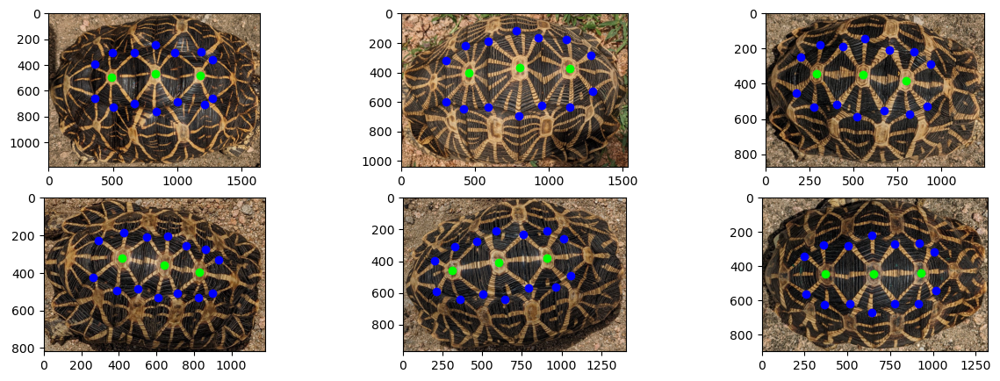

In [6]:
fig = plt.figure(figsize=(15, 5))
axes = fig.subplots(2, 3)
flat_axes = axes.flatten()
np.random.seed(123)
random_image_idx = np.random.randint(len(image_paths), size=len(flat_axes))
xml_path = 'annotations_v3.xml'

for i in range(len(flat_axes)):

    # Read image.
    image_path = image_paths[random_image_idx[i]]
    image = img.imread(image_path)
    flat_axes[i].imshow(image)

    # Plot landmarks.
    image_name = os.path.split(image_path)[-1]
    corners, centers = get_landmarks(xml_path, image_name)
    corn_x = [i[0] for i in corners]
    corn_y = [i[1] for i in corners]
    cent_x = [i[0] for i in centers]
    cent_y = [i[1] for i in centers]
    flat_axes[i].scatter(corn_x, corn_y, c='b')
    flat_axes[i].scatter(cent_x, cent_y, c='lime')

plt.show()

In [7]:
length = 299
resized_imgs = []
targets = []
xml_path = 'annotations_v3.xml'
for image_path in image_paths:
    # Resize images.
    image = img.imread(image_path)
    resized_img = tf.image.resize(image, (length,length), method='nearest')
    resized_imgs.append(resized_img)

    # Resize landmarks.
    image_name = os.path.split(image_path)[-1]
    corners, centers = get_landmarks(xml_path, image_name)
    corn_x = [i[0] for i in corners]
    corn_y = [i[1] for i in corners]
    cent_x = [i[0] for i in centers]
    cent_y = [i[1] for i in centers]
    resized_x = np.rint(np.append(corn_x, cent_x) * (length/image.shape[1])).astype(int)
    resized_y = np.rint(np.append(corn_y, cent_y) * (length/image.shape[0])).astype(int)

    targets.append(np.dstack((resized_x, resized_y)).flatten())

resized_imgs = np.array(resized_imgs)
targets = np.array(targets)

2022-10-02 23:14:02.882384: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2022-10-02 23:14:02.882688: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


Metal device set to: Apple M1 Pro


In [96]:
def plot_images_landmarks(images, landmarks, rows=2, cols=3):
    fig = plt.figure(figsize=(20, 5*rows))
    axes = fig.subplots(rows, cols)
    flat_axes = axes.flatten()
    
    # Do without replacement
    np.random.seed(123)
    random_image_idx = random.sample(range(len(images)), k=len(flat_axes))
#     random_image_idx = np.random.randint(len(images), size=len(flat_axes))

    for i in range(len(flat_axes)):
        rand_int = random_image_idx[i]
        
        # Read image.
        flat_axes[i].imshow(images[rand_int])

        # Plot landmarks.
        corn_x = []
        corn_y = []
        for coord in zip(landmarks[rand_int, :-6:2], landmarks[rand_int, 1:-6:2]):
            corn_x.append(coord[0])
            corn_y.append(coord[1])

        cent_x = []
        cent_y = []
        for coord in zip(landmarks[rand_int, -6::2], landmarks[rand_int, -5::2]):
            cent_x.append(coord[0])
            cent_y.append(coord[1])
        flat_axes[i].scatter(corn_x, corn_y, c='b')
        flat_axes[i].scatter(cent_x, cent_y, c='lime')

    plt.show()

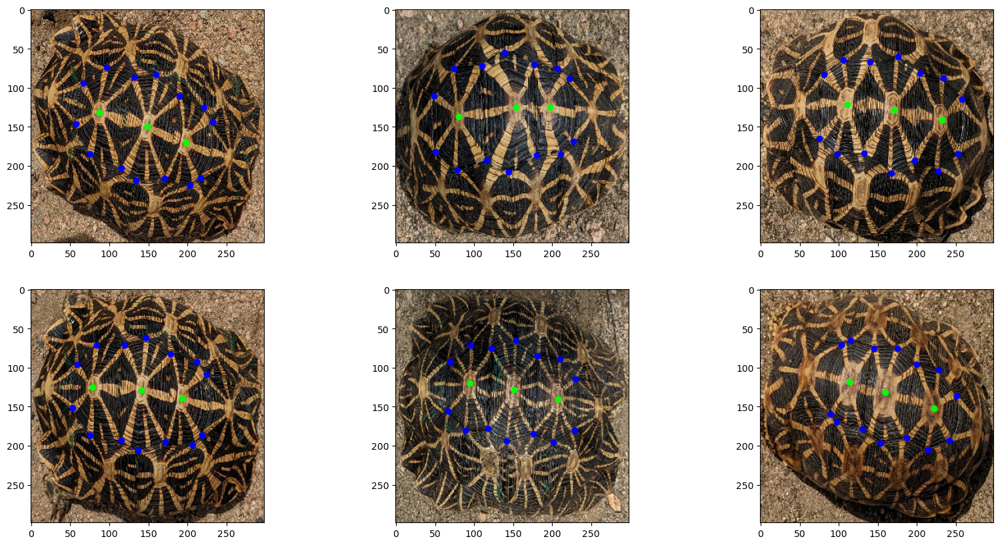

In [97]:
plot_images_landmarks(resized_imgs, targets)

In [10]:
print(resized_imgs.shape)
print(targets.shape)

(51, 299, 299, 3)
(51, 34)


# Augmentation

In [11]:
train_images = resized_imgs
train_keypoints = targets

## Flip

In [12]:
def flip_images_landmarks(images, landmarks):
    flipped_images = []
    flipped_landmarks = []
    for image, landmark in zip(images, landmarks):
        flipped_images.append(cv2.flip(image, 0))
        landmark = landmark.copy()
        landmark[1::2] = landmark[1::2] + ((image.shape[0]/2)-landmark[1::2])*2
        flipped_landmarks.append(landmark)

    return np.array(flipped_images), np.array(flipped_landmarks)

(51, 299, 299, 3)
(51, 34)


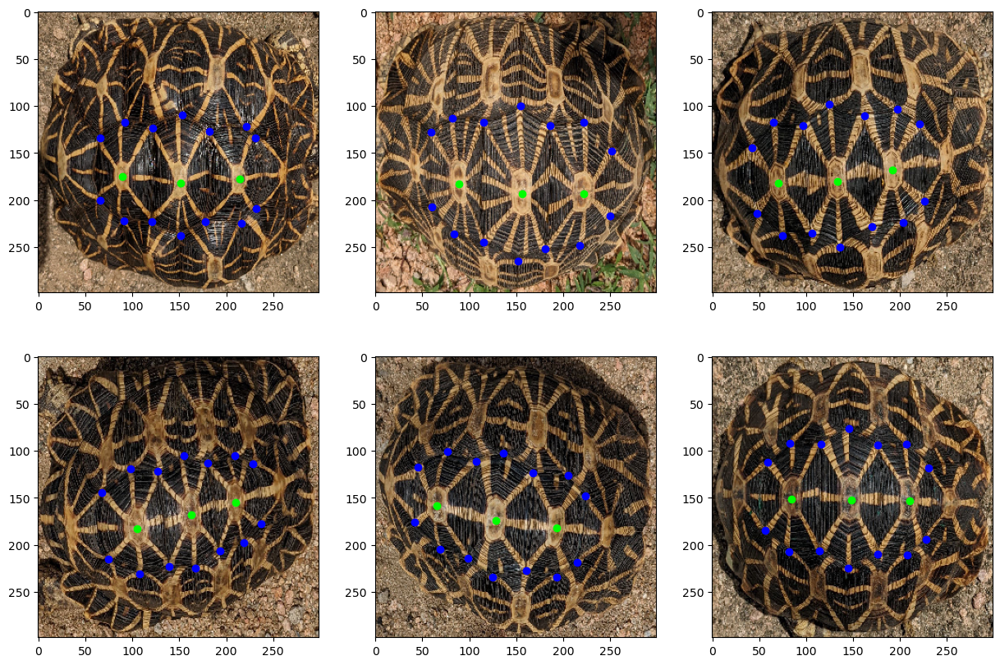

In [13]:
flipped_images, flipped_landmarks = flip_images_landmarks(train_images, train_keypoints)
print(flipped_images.shape)
print(flipped_landmarks.shape)
plot_images_landmarks(flipped_images, flipped_landmarks)

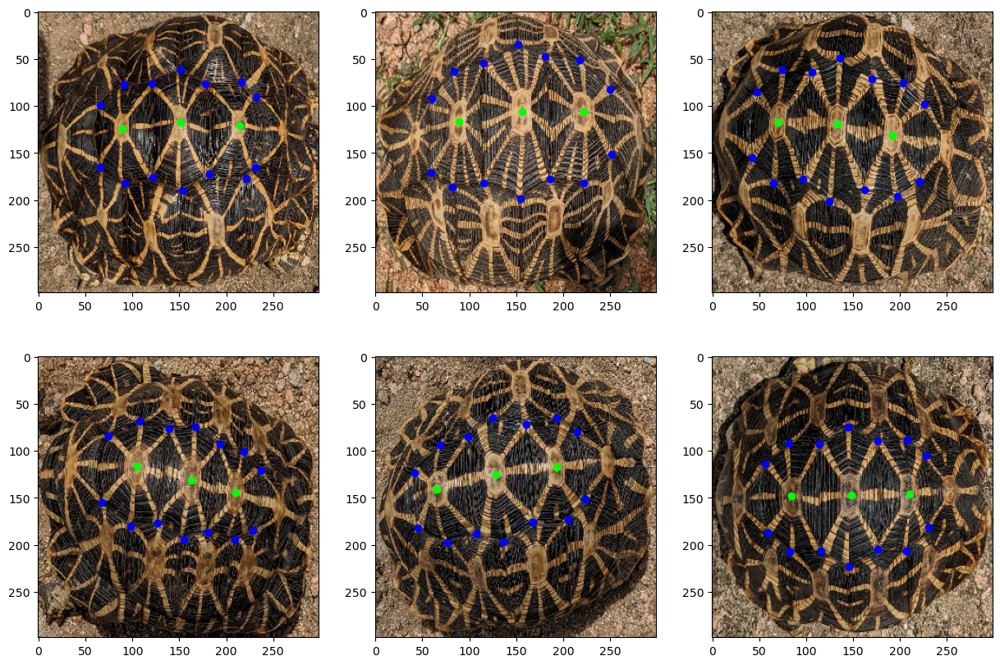

In [14]:
plot_images_landmarks(train_images, train_keypoints)

In [15]:
train_images = np.concatenate((train_images, flipped_images))
train_keypoints = np.concatenate((train_keypoints, flipped_landmarks))

In [16]:
print(train_images.shape)
print(train_keypoints.shape)

(102, 299, 299, 3)
(102, 34)


## Rotate

In [17]:
np.arange(6, 360, 6)

array([  6,  12,  18,  24,  30,  36,  42,  48,  54,  60,  66,  72,  78,
        84,  90,  96, 102, 108, 114, 120, 126, 132, 138, 144, 150, 156,
       162, 168, 174, 180, 186, 192, 198, 204, 210, 216, 222, 228, 234,
       240, 246, 252, 258, 264, 270, 276, 282, 288, 294, 300, 306, 312,
       318, 324, 330, 336, 342, 348, 354])

In [18]:
def rotate_images_landmarks(images, landmarks, angles=[12]):
    rotated_images = []
    rotated_landmarks = []
    for angle in angles:
        for image, landmark in zip(images, landmarks):
            width, height = image.shape[:2]
            M = cv2.getRotationMatrix2D((width/2, height/2), angle, 1)
            rotated_images.append(cv2.warpAffine(image, M, (width, height), flags=cv2.INTER_CUBIC))
            angle_cos, angle_sin = M[0, 0], M[1, 0]

            rotated_landmark = []
            for i in range(0, len(landmark), 2):
                x, y = landmark[i] - width/2, landmark[i+1] - height/2
                rot_x = (x*angle_cos) - (y*angle_sin)
                rot_y = (y*angle_cos) + (x*angle_sin)
                rotated_landmark += [rot_x+width/2, rot_y+height/2]

            rotated_landmarks.append(rotated_landmark)


    return np.array(rotated_images), np.array(rotated_landmarks)

(3978, 299, 299, 3)
(3978, 34)


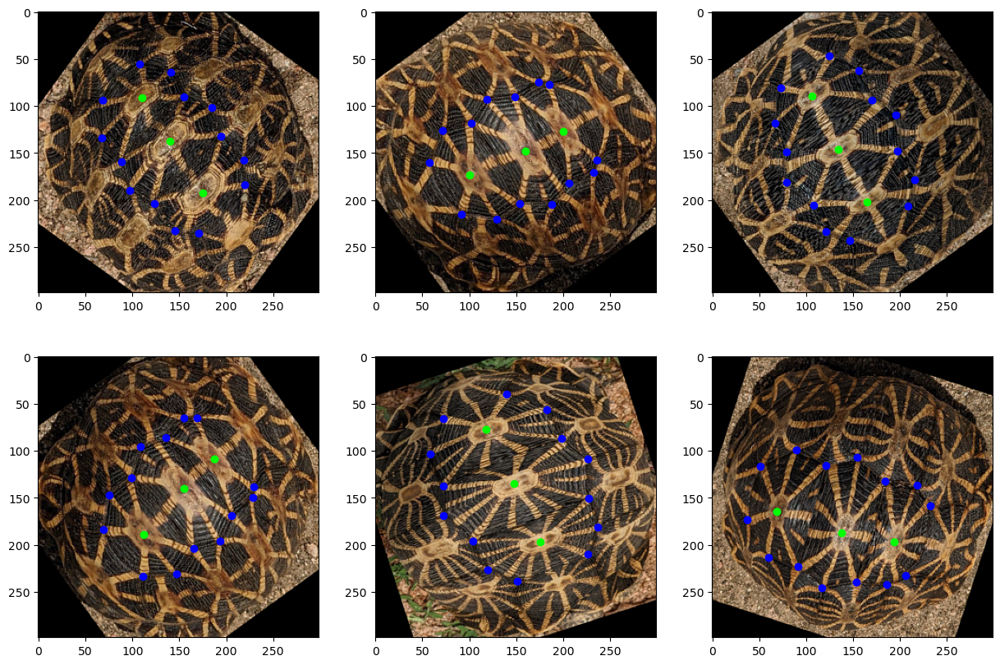

In [19]:
rotated_images, rotated_landmarks = rotate_images_landmarks(train_images, train_keypoints, np.arange(9, 360, 9))
print(rotated_images.shape)
print(rotated_landmarks.shape)
plot_images_landmarks(rotated_images, rotated_landmarks)

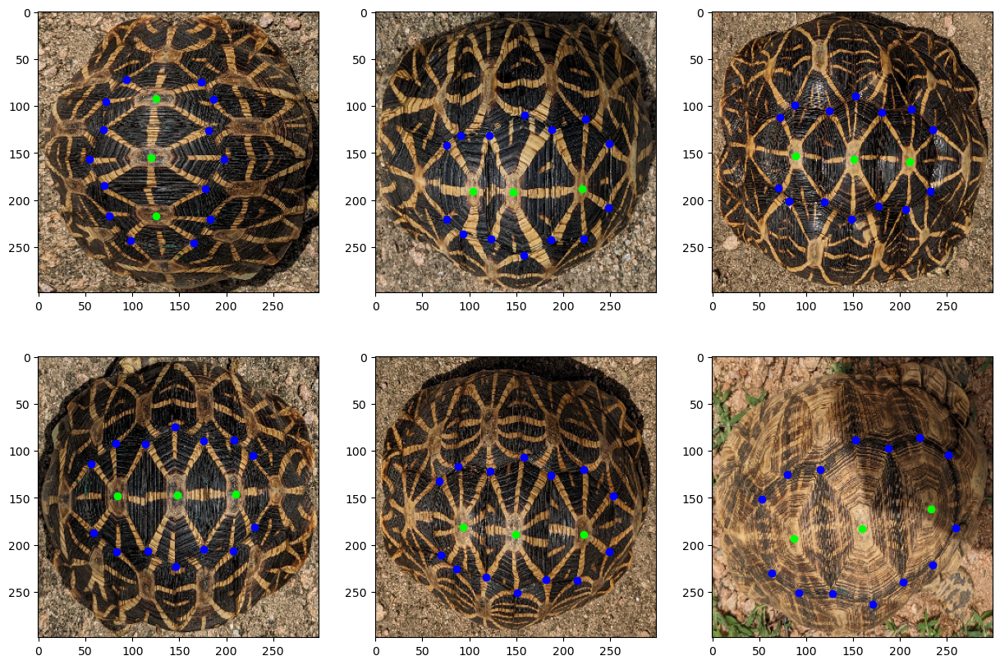

In [20]:
plot_images_landmarks(train_images, train_keypoints)

In [21]:
train_images = np.concatenate((train_images, rotated_images))
train_keypoints = np.concatenate((train_keypoints, rotated_landmarks))

In [22]:
print(train_images.shape)
print(train_keypoints.shape)

(4080, 299, 299, 3)
(4080, 34)


## Shift

In [23]:
def shift_images(images, keypoints, pixels=[12]):
    shifted_images = []
    shifted_keypoints = []
    for shift in pixels:    # Augmenting over several pixel shift values
        for (shift_x,shift_y) in [(-shift,-shift),(-shift,shift),(shift,-shift),(shift,shift)]:
            M = np.float32([[1,0,shift_x],[0,1,shift_y]])
            for image, keypoint in zip(images, keypoints):
                shifted_image = cv2.warpAffine(image, M, (299,299), flags=cv2.INTER_CUBIC)
                shifted_keypoint = np.array([(point+shift_x) if idx%2==0 else (point+shift_y) for idx, point in enumerate(keypoint)])
                if np.all(0.0<shifted_keypoint) and np.all(shifted_keypoint<299.0):
                    shifted_images.append(shifted_image.reshape(299, 299, 3))
                    shifted_keypoints.append(shifted_keypoint)
    shifted_keypoints = np.clip(shifted_keypoints,0.0,299.0)
    return shifted_images, shifted_keypoints

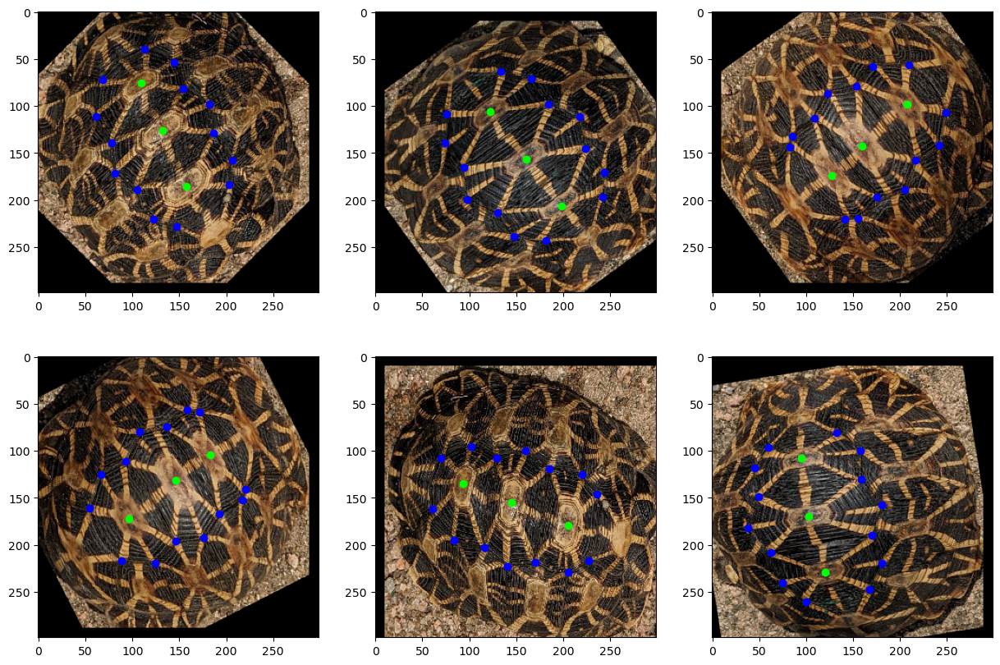

In [24]:
shifted_train_images, shifted_train_keypoints = shift_images(train_images, train_keypoints, pixels=[10])
plot_images_landmarks(shifted_train_images, shifted_train_keypoints)

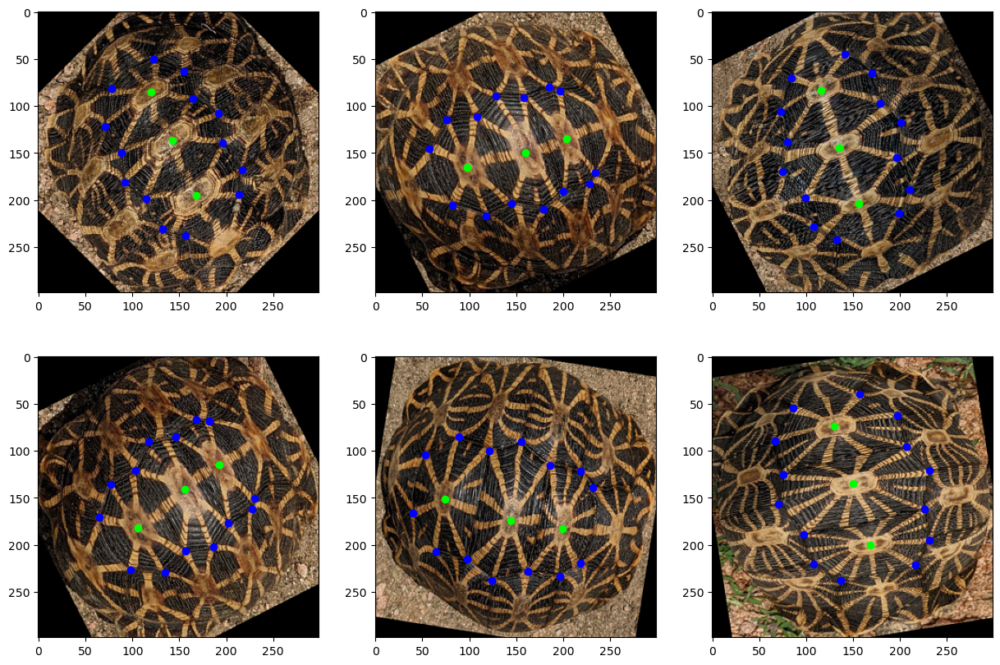

In [25]:
plot_images_landmarks(train_images, train_keypoints)

In [26]:
train_images = np.concatenate((train_images, shifted_train_images))
train_keypoints = np.concatenate((train_keypoints, shifted_train_keypoints))

In [27]:
print(train_images.shape)
print(train_keypoints.shape)

(20400, 299, 299, 3)
(20400, 34)


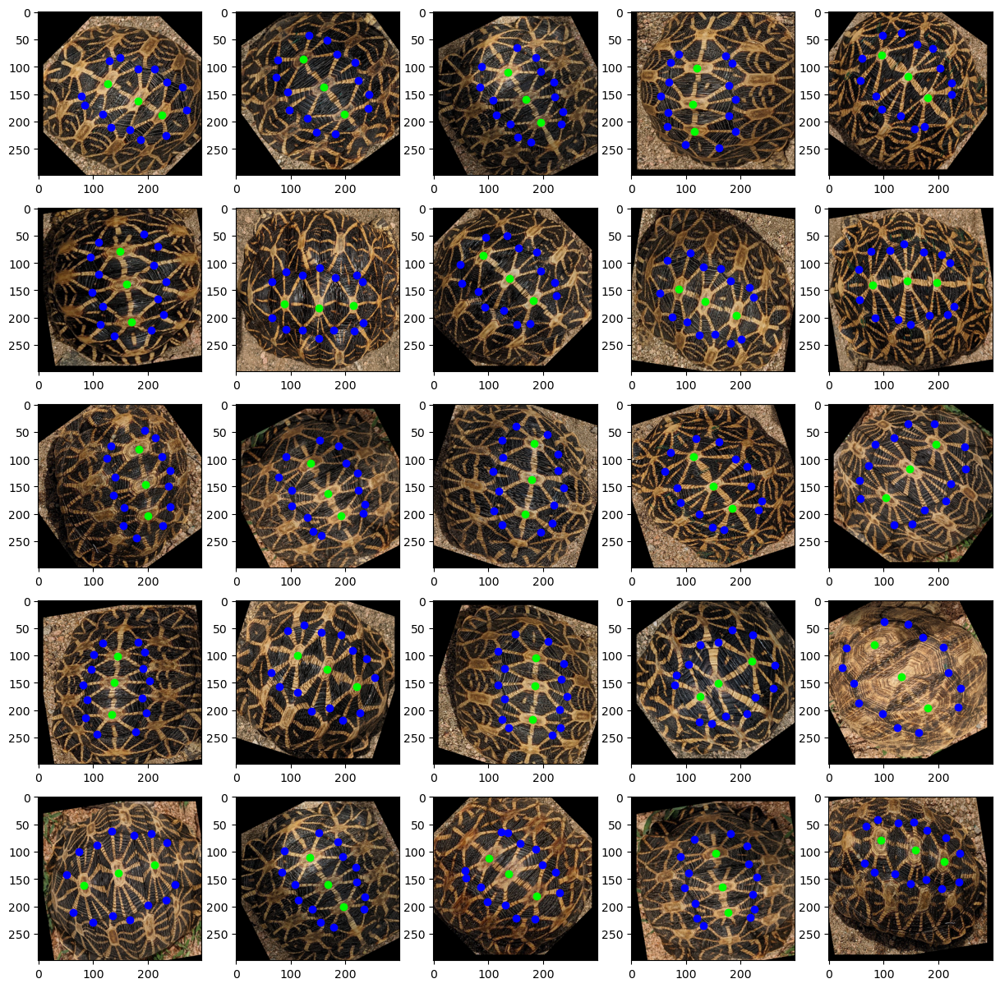

In [43]:
plot_images_landmarks(train_images, train_keypoints, rows=5, cols=5)

# Model

In [29]:
base_model = keras.applications.inception_v3.InceptionV3(
    include_top=False, pooling='avg'
    )

In [30]:
# Want the last layer to be dense layer with 34 nodes
inputs = keras.Input(shape=(299, 299, 3))
x = base_model(inputs, training=True)
x = keras.layers.Dropout(0.1)(x)
outputs = keras.layers.Dense(34)(x)
model = keras.Model(inputs, outputs)

model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
    loss='mean_squared_error',
    metrics=['acc'],
    )
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 299, 299, 3)]     0         
                                                                 
 inception_v3 (Functional)   (None, 2048)              21802784  
                                                                 
 dropout (Dropout)           (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 34)                69666     
                                                                 
Total params: 21,872,450
Trainable params: 21,838,018
Non-trainable params: 34,432
_________________________________________________________________


In [31]:
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau

# Define callbacks

# Early stopping if no improvement
early_stop = EarlyStopping(monitor = 'val_loss', 
                           patience = 16,
                           mode = 'min',
                           baseline=None,
                           restore_best_weights=True)

# Reduce learning rate when a metric has stopped improving.
reduce_lr = ReduceLROnPlateau(monitor = 'val_loss', 
                              factor = 0.5,
                              patience = 8,
                              min_lr = 1e-15,
                              mode = 'min', 
                              verbose = 1)

In [32]:
64*2*2

256

In [33]:
history=model.fit(x=train_images,
                  y=train_keypoints,
                  epochs=500,
                  batch_size=64,
                  validation_split=1/4,
                  callbacks=[early_stop, reduce_lr]
                )

2022-10-02 23:15:10.124599: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


Epoch 1/500


2022-10-02 23:15:14.479485: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


240/240 [==============================] - ETA: 0s - loss: 7885.0825 - acc: 0.1394

2022-10-02 23:21:07.087556: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


240/240 [==============================] - 398s 2s/step - loss: 7885.0825 - acc: 0.1394 - val_loss: 3010.9624 - val_acc: 0.3331 - lr: 0.0010
Epoch 2/500
240/240 [==============================] - 395s 2s/step - loss: 1479.2844 - acc: 0.4324 - val_loss: 1129.9742 - val_acc: 0.4796 - lr: 0.0010
Epoch 3/500
240/240 [==============================] - 390s 2s/step - loss: 285.8311 - acc: 0.6357 - val_loss: 536.9162 - val_acc: 0.5667 - lr: 0.0010
Epoch 4/500
240/240 [==============================] - 390s 2s/step - loss: 128.5352 - acc: 0.7307 - val_loss: 478.3374 - val_acc: 0.6243 - lr: 0.0010
Epoch 5/500
240/240 [==============================] - 394s 2s/step - loss: 79.4385 - acc: 0.7720 - val_loss: 400.5546 - val_acc: 0.6251 - lr: 0.0010
Epoch 6/500
240/240 [==============================] - 395s 2s/step - loss: 64.8938 - acc: 0.7845 - val_loss: 404.4328 - val_acc: 0.6406 - lr: 0.0010
Epoch 7/500
240/240 [==============================] - 395s 2s/step - loss: 67.6060 - acc: 0.7858 - val_

Epoch 106/500
240/240 [==============================] - ETA: 0s - loss: 2.0073 - acc: 0.9408
Epoch 106: ReduceLROnPlateau reducing learning rate to 6.25000029685907e-05.
240/240 [==============================] - 388s 2s/step - loss: 2.0073 - acc: 0.9408 - val_loss: 24.8191 - val_acc: 0.8814 - lr: 1.2500e-04


2/2 [==============================] - 1s 545ms/step


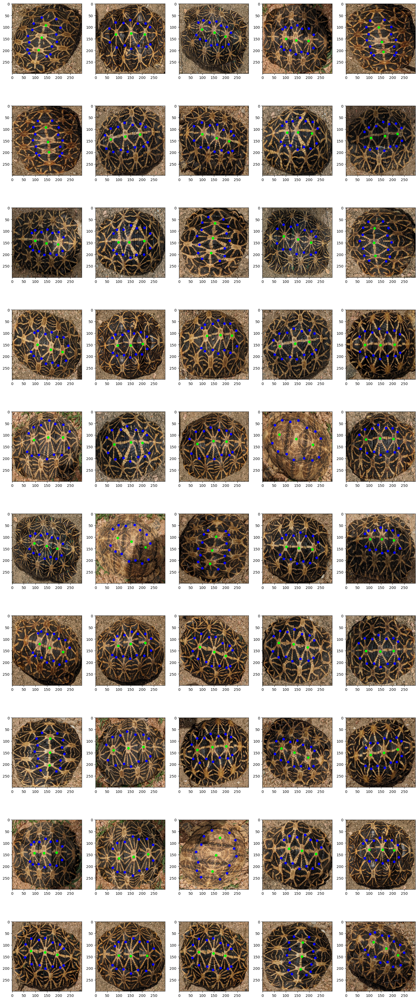

In [99]:
pred = model.predict(resized_imgs)

plot_images_landmarks(resized_imgs, pred, rows=10, cols=5)

In [36]:
import joblib
joblib.dump(model, "model.joblib")

INFO:tensorflow:Assets written to: ram://5697c8bd-eafa-4613-ad58-5750f73b9d66/assets


INFO:tensorflow:Assets written to: ram://5697c8bd-eafa-4613-ad58-5750f73b9d66/assets


['model.joblib']

In [37]:
model.save('loss=23/model.h5')

2022-10-03 12:05:42.959234: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


2/2 [==============================] - 3s 1s/step


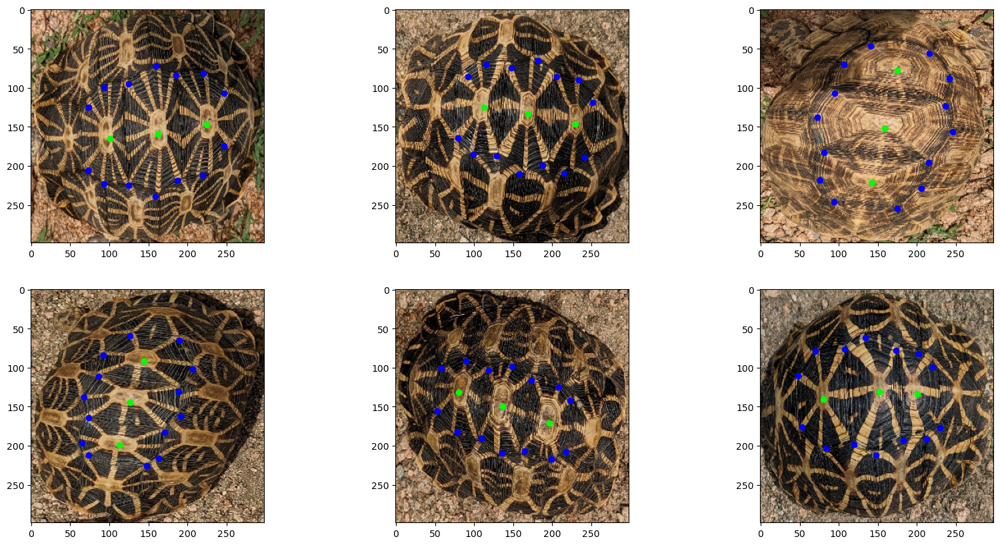

In [101]:
moot = joblib.load("loss=23/model.joblib")

pred = moot.predict(resized_imgs)
plot_images_landmarks(resized_imgs, pred)